# TSNE
The goal of this notebook is the analysis of the embeddings. Doing this for all models is probably not that useful, so I will do it for the model that performs best, on average. This is VGG16.

In [2]:
import seaborn as sns
from functions import *
from sklearn.manifold import TSNE

In [6]:
article_df = pd.read_feather(idp('articles_processed.feather'))
article_df.head()

,article_id,product_code,prod_name,product_type_no,product_type_name,product_group_name,graphical_appearance_no,graphical_appearance_name,colour_group_code,colour_group_name,...,index_name,index_group_no,index_group_name,section_no,section_name,garment_group_no,garment_group_name,detail_desc,image_name,popularity
0,0108775015,108775,Strap top,253,Vest top,Garment Upper body,0,Solid,9,Black,...,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.,010/0108775015.jpg,0.215583
1,0108775044,108775,Strap top,253,Vest top,Garment Upper body,0,Solid,10,White,...,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.,010/0108775044.jpg,0.144172
2,0108775051,108775,Strap top (1),253,Vest top,Garment Upper body,1,Stripe,11,Off White,...,Ladieswear,1,Ladieswear,16,Womens Everyday Basics,1002,Jersey Basic,Jersey top with narrow shoulder straps.,010/0108775051.jpg,0.004275
3,0110065001,110065,OP T-shirt (Idro),306,Bra,Underwear,0,Solid,9,Black,...,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde...",011/0110065001.jpg,0.020761
4,0110065002,110065,OP T-shirt (Idro),306,Bra,Underwear,0,Solid,10,White,...,Lingeries/Tights,1,Ladieswear,61,Womens Lingerie,1017,"Under-, Nightwear","Microfibre T-shirt bra with underwired, moulde...",011/0110065002.jpg,0.010718


In [3]:
# obtain column names (and the number of unique values they have)
col_unique = {col: article_df[col].nunique() for col in article_df.columns.values}
for col_name, col_count in col_unique.items():
    if col_count < 35 and not col_name.endswith('id') and not col_name.endswith('no'):
        print(col_name, col_count)

product_group_name 19
graphical_appearance_name 30
perceived_colour_value_name 8
perceived_colour_master_name 20
index_name 10
index_group_name 5
garment_group_name 21


## Embeddings without extension
Start with the embeddings that are derived from the images without any extensions.

In [3]:
embeddings_df = pd.read_feather(odp('embeddings/embeddings_VGG16_W128_H128/embeddings.feather'))
embeddings_df = embeddings_df.drop(columns='article_id')
embeddings_df.head()

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
0,0.000000,0.000000,0.000000,0.0,110.076820,0.0,0.000000,0.000000,0.0,6.405939,...,0.00000,94.858894,3.926529,0.0,25.887436,0.000000,0.0,2.486832,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.0,44.180119,0.0,26.237511,5.215271,0.0,0.000000,...,0.00000,0.000000,3.079439,0.0,0.000000,6.714375,0.0,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.0,58.134380,0.0,0.000000,0.000000,0.0,0.000000,...,0.00000,58.912567,0.000000,0.0,57.953796,0.000000,0.0,0.000000,0.000000,2.434532
3,76.259758,0.000000,9.570256,0.0,89.001747,0.0,0.000000,0.000000,0.0,42.044685,...,0.00000,21.164175,23.721464,0.0,0.000000,0.000000,0.0,49.731426,0.000000,8.202670
4,18.765467,6.115397,0.000000,0.0,27.171282,0.0,22.754181,0.000000,0.0,1.194362,...,3.18132,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,6.367054,0.000000


In [4]:
%%time

tsne = TSNE(n_components=2, verbose=0, perplexity=40, n_iter=250)
tsne_results = tsne.fit_transform(embeddings_df)

/home/jana/anaconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/jana/anaconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


CPU times: user 31min 50s, sys: 13.5 s, total: 32min 4s
Wall time: 2min 31s


In [7]:
article_df['tsne-2d-x'] = tsne_results[:, 0]
article_df['tsne-2d-y'] = tsne_results[:, 1]
del tsne
del tsne_results

In [8]:
def plot(column_name):
    plt.figure(figsize=(16,10))
    sns.scatterplot(
        x="tsne-2d-x", y="tsne-2d-y",
        hue=column_name,
        data=article_df,
        legend="full",
        alpha=0.8,
        s=5
    )

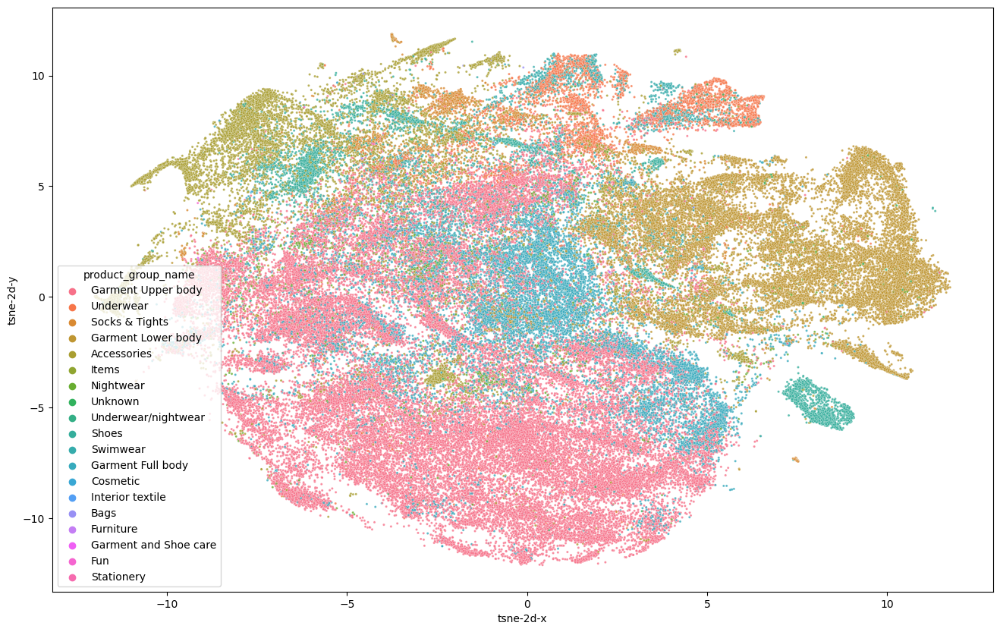

In [9]:
plot(column_name="product_group_name")

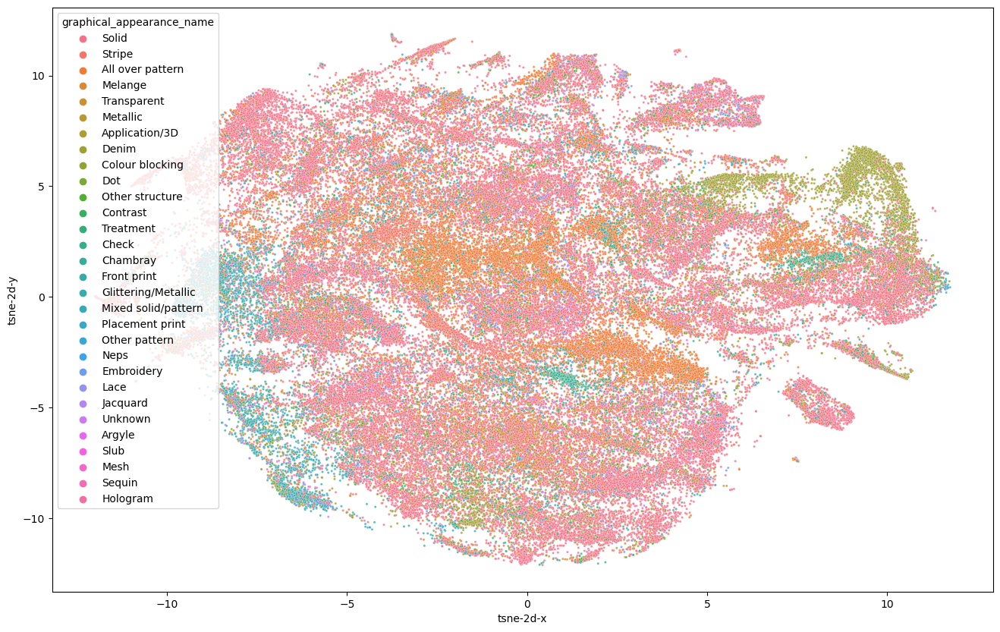

In [10]:
plot(column_name="graphical_appearance_name")

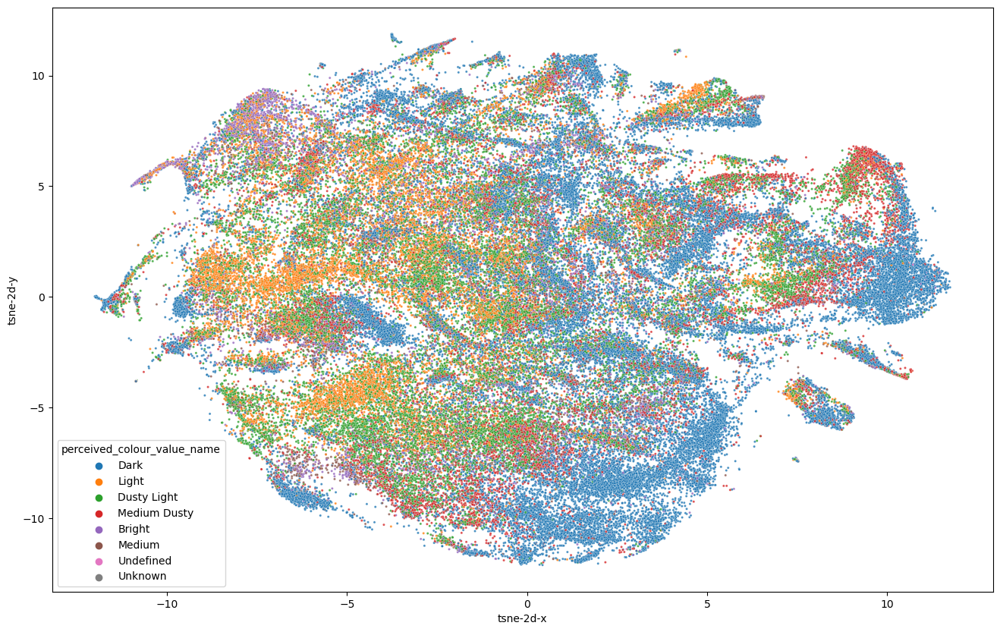

In [11]:
plot(column_name="perceived_colour_value_name")

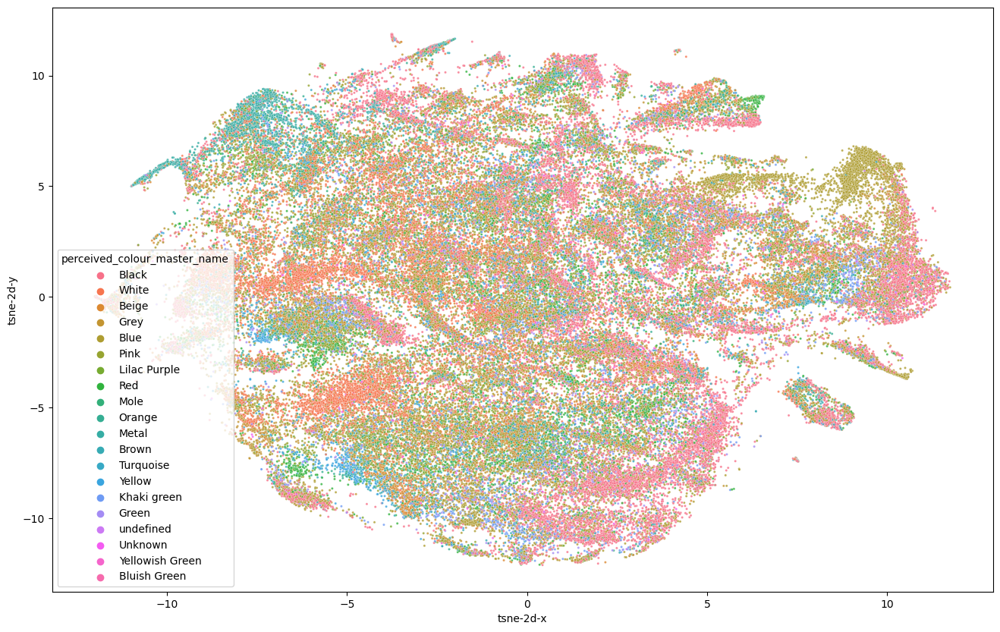

In [12]:
plot(column_name="perceived_colour_master_name")

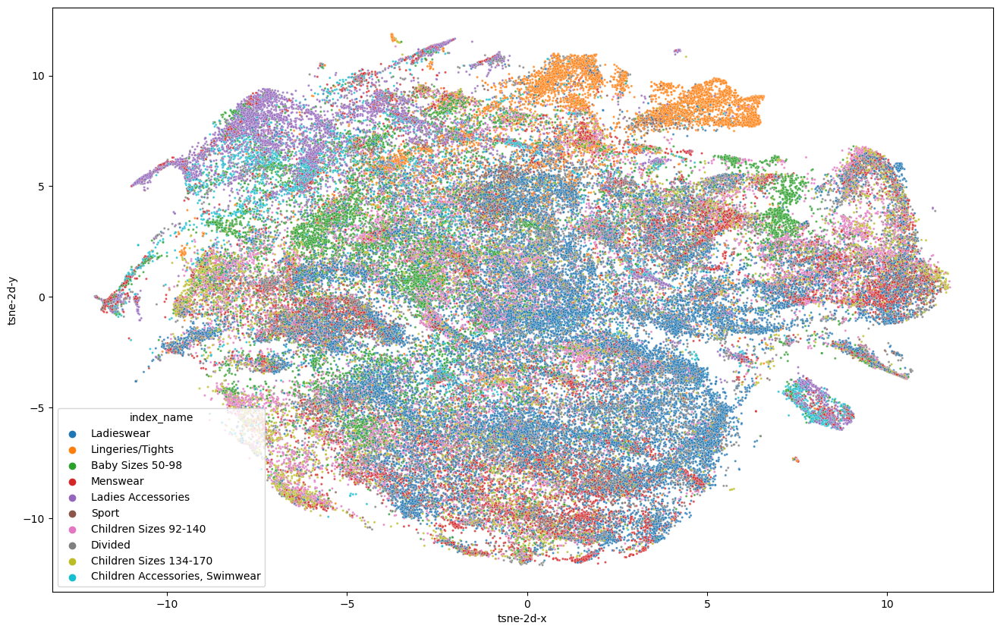

In [13]:
plot(column_name="index_name")

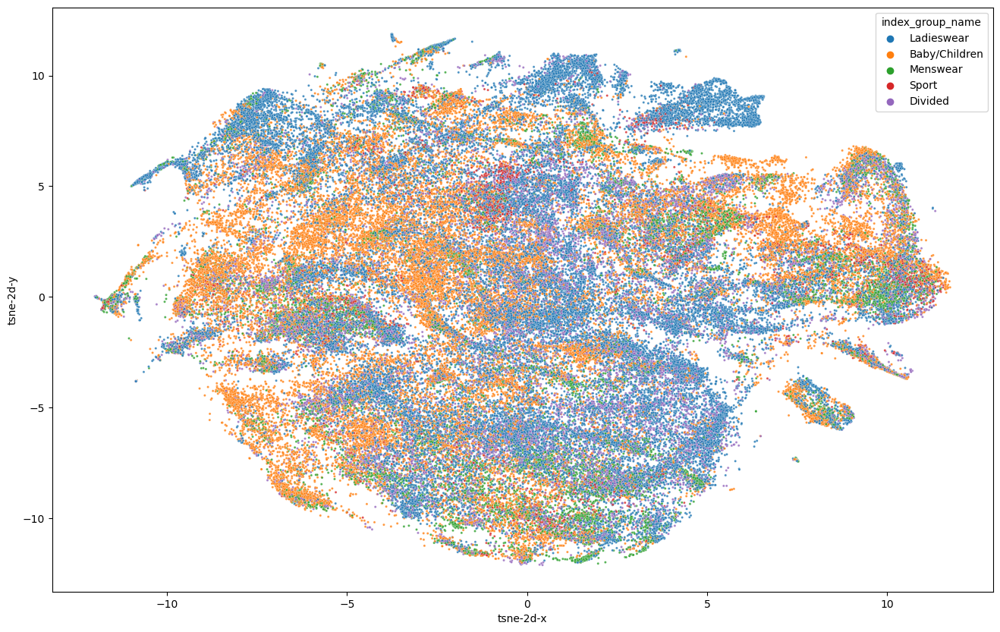

In [14]:
plot(column_name="index_group_name")

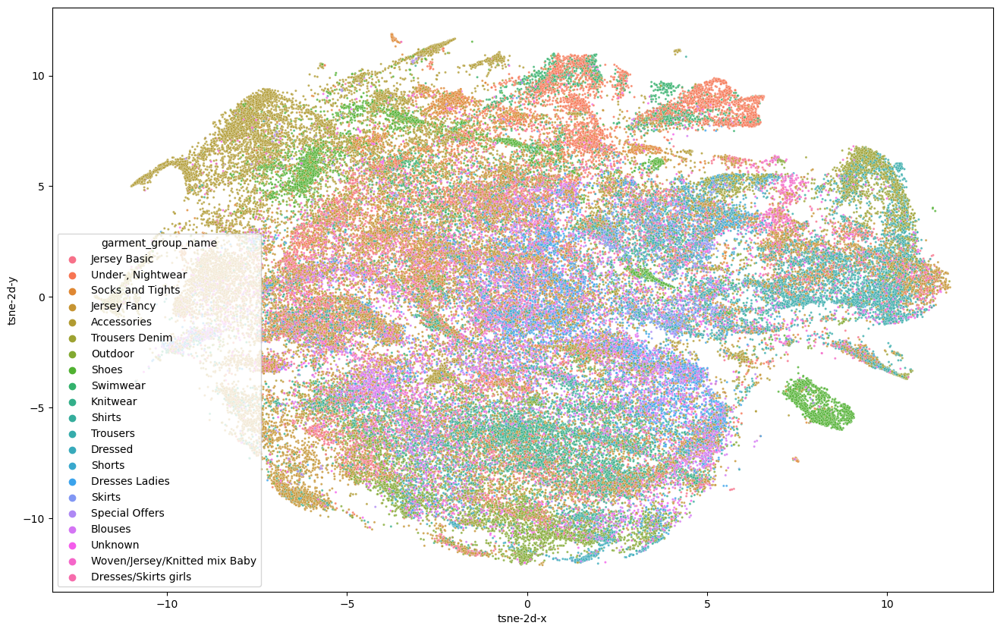

In [15]:
plot(column_name="garment_group_name")

## Extended embeddings
Now do the same for the extended embeddings.

In [16]:
ext_embeddings_df = pd.read_feather(odp('embeddings/extended_embeddings_VGG16_W128_H128/embeddings.feather'))
ext_embeddings_df = ext_embeddings_df.drop(columns='article_id')
ext_embeddings_df.head()

,0,1,2,3,4,5,6,7,8,9,...,802,803,804,805,806,807,808,809,810,811
0,0.000000,0.000000,0.000000,0.0,110.076820,0.0,0.000000,0.000000,0.0,6.405939,...,-1.959370,0.741300,0.491621,0.566526,-1.290464,2.533957,-0.196161,-1.875800,-0.681104,-1.346071
1,0.000000,0.000000,0.000000,0.0,44.180119,0.0,26.237511,5.215271,0.0,0.000000,...,-1.959370,0.741300,0.491621,0.566526,-1.290464,2.533957,-0.196161,-1.875800,-0.681104,-1.346071
2,0.000000,0.000000,0.000000,0.0,58.134380,0.0,0.000000,0.000000,0.0,0.000000,...,-1.959370,0.741300,0.491621,0.566526,-1.290464,2.533957,-0.196161,-1.875800,-0.681104,-1.346071
3,76.259758,0.000000,9.570256,0.0,89.001747,0.0,0.000000,0.000000,0.0,42.044685,...,-1.044683,0.230616,-0.000225,-0.578778,-1.060150,1.898527,-0.064709,-1.300787,-1.688655,-0.326281
4,18.765467,6.115397,0.000000,0.0,27.171282,0.0,22.754181,0.000000,0.0,1.194362,...,-1.044683,0.230616,-0.000225,-0.578778,-1.060150,1.898527,-0.064709,-1.300787,-1.688655,-0.326281


In [17]:
%%time

ext_tsne = TSNE(n_components=2, verbose=0, perplexity=40, n_iter=250)
ext_tsne_results = ext_tsne.fit_transform(ext_embeddings_df)

/home/jana/anaconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/jana/anaconda3/envs/tf/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


CPU times: user 39min 51s, sys: 12 s, total: 40min 3s
Wall time: 3min 10s


In [18]:
article_df['tsne-2d-x'] = ext_tsne_results[:, 0]
article_df['tsne-2d-y'] = ext_tsne_results[:, 1]
del ext_tsne
del ext_tsne_results

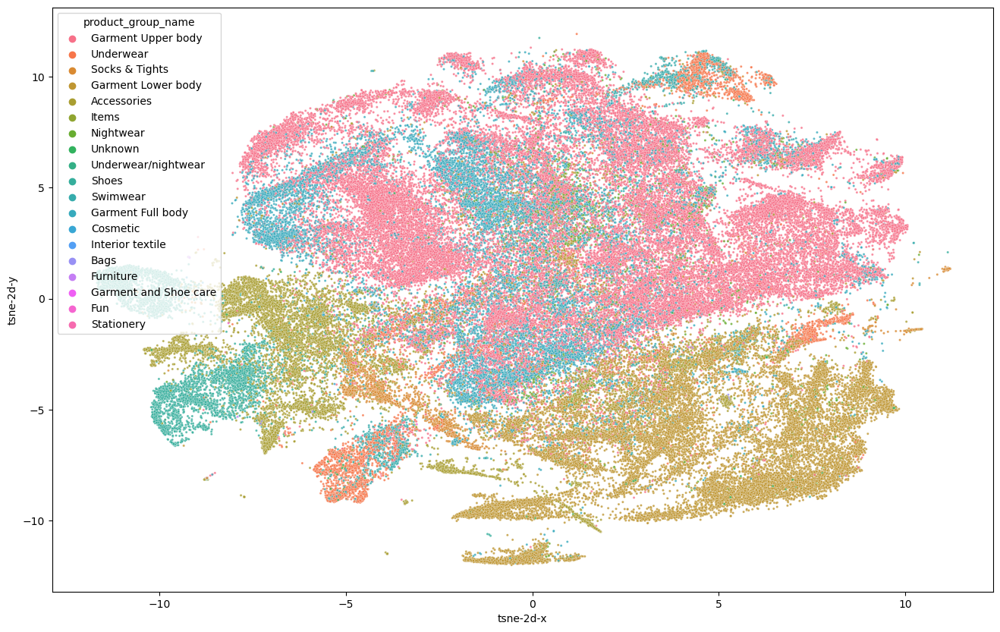

In [19]:
plot(column_name="product_group_name")

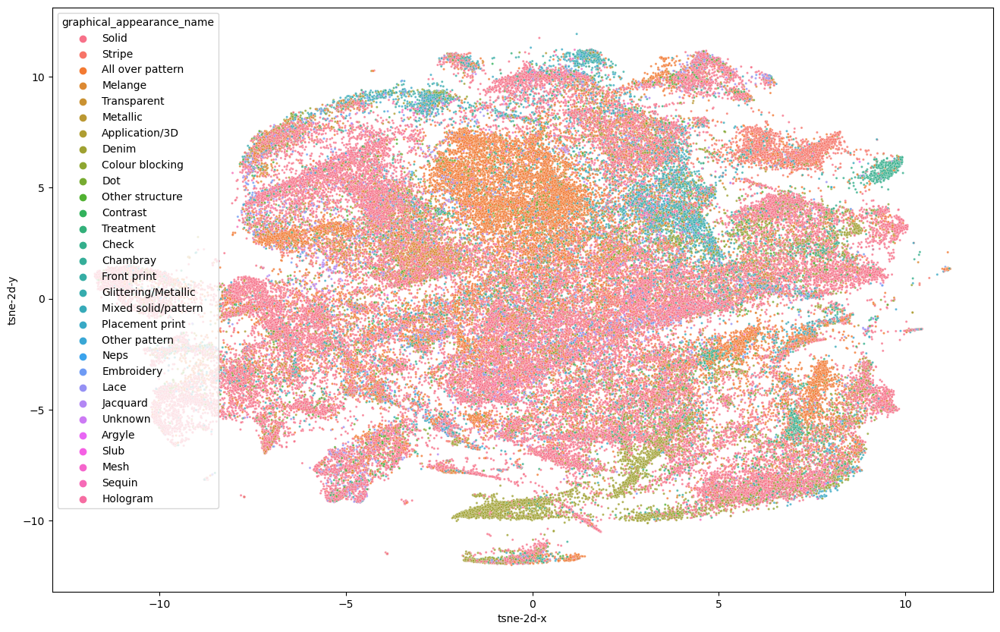

In [20]:
plot(column_name="graphical_appearance_name")

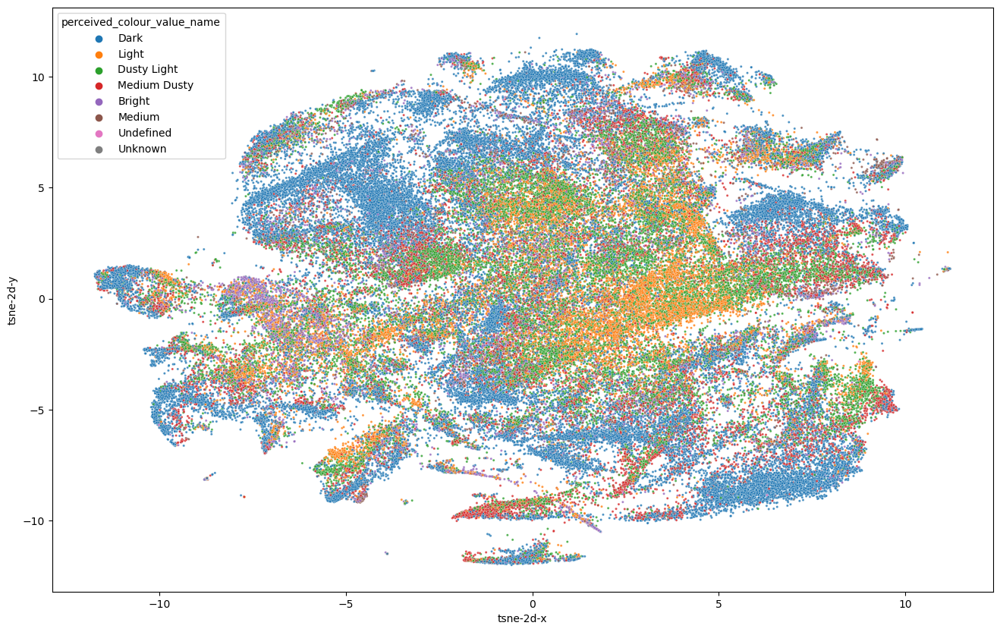

In [21]:
plot(column_name="perceived_colour_value_name")

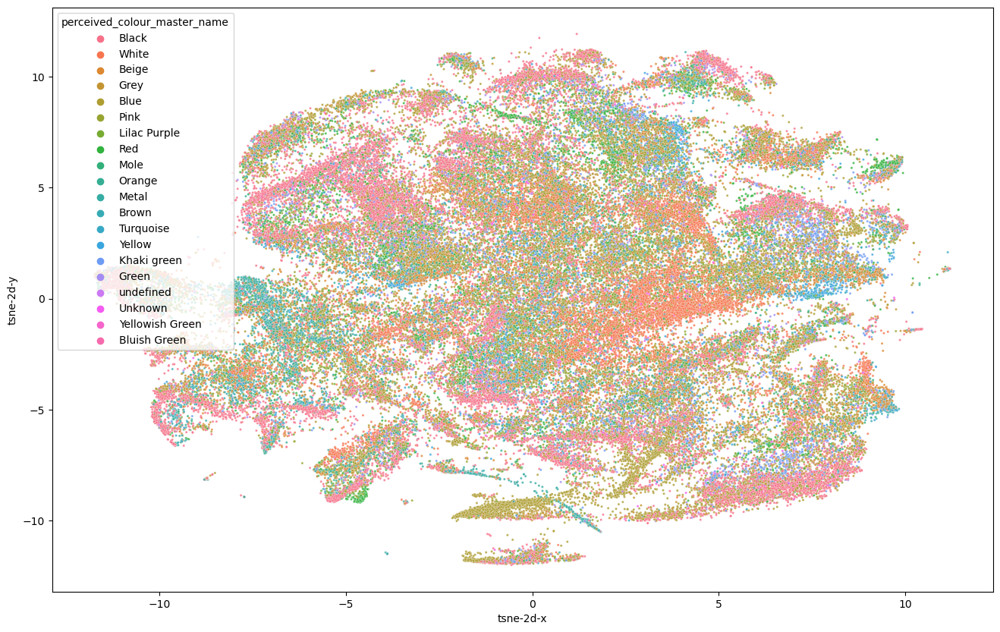

In [22]:
plot(column_name="perceived_colour_master_name")

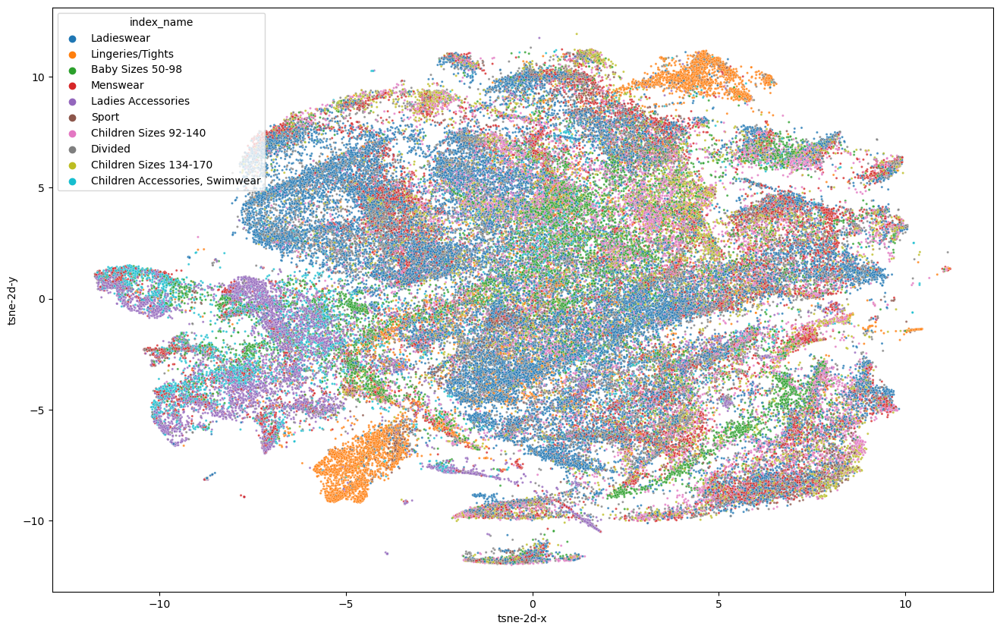

In [23]:
plot(column_name="index_name")

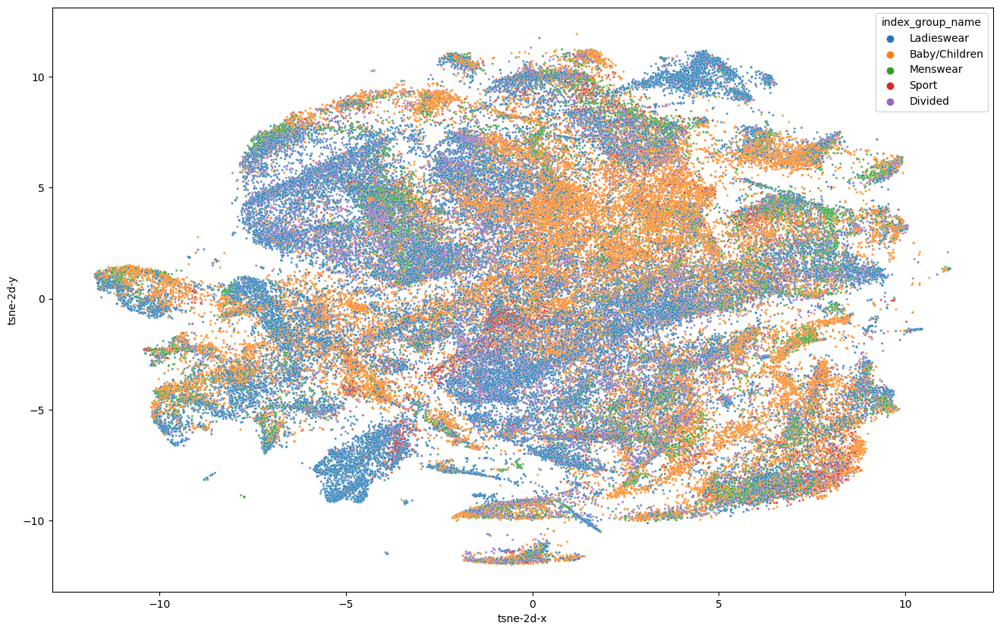

In [24]:
plot(column_name="index_group_name")

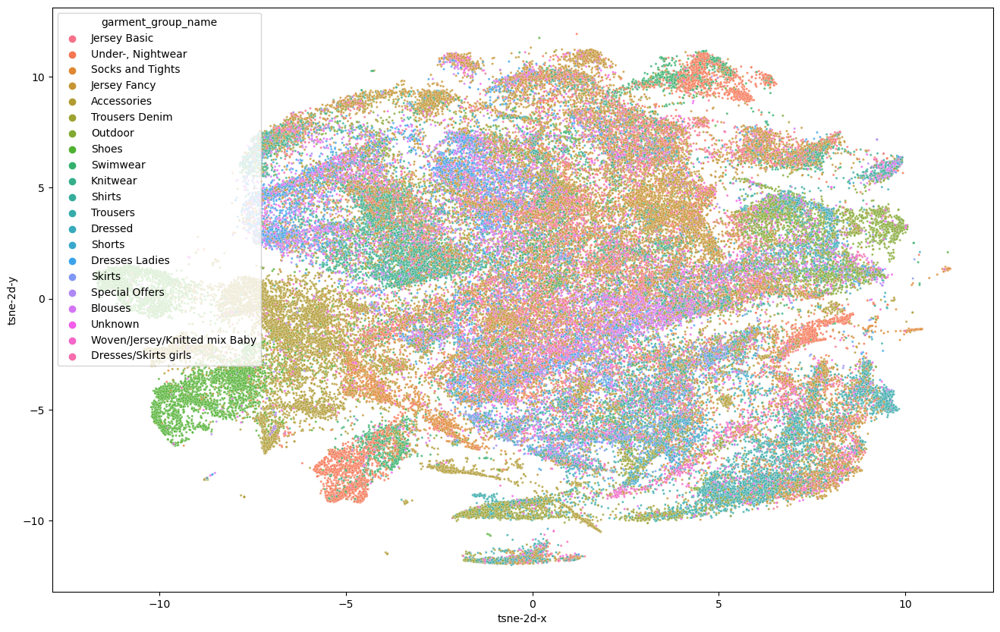

In [25]:
plot(column_name="garment_group_name")